In [2]:
library(Seurat)
library(tidyverse)

Attaching SeuratObject

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.3.6      ✔ purrr   0.3.4 
✔ tibble  3.1.8      ✔ dplyr   1.0.10
✔ tidyr   1.2.1      ✔ stringr 1.4.1 
✔ readr   2.1.2      ✔ forcats 0.5.2 
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


In [3]:
LoadResolveBaysor <- function(data.dir, fov = 'fov', assay = 'Xenium') {
  data <- ReadXenium(
    data.dir = data.dir,
    type = c("centroids", "segmentations"),
  )

  segmentations.data <- list(
    "centroids" = CreateCentroids(data$centroids),
    "segmentation" = CreateSegmentation(data$segmentations)
  )
  coords <- CreateFOV(
    coords = segmentations.data,
    type = c("segmentation", "centroids"),
    molecules = data$microns,
    assay = assay
  )
  counts = data$matrix
  zeros <- Matrix::sparseMatrix(i = integer(0), j = integer(0), dims = dim(counts), 
                          dimnames = dimnames(counts))
  zeros <- as(zeros, "dgCMatrix")
  data$matrix = list()
  data$matrix[["Gene Expression"]] = counts
  data$matrix[["BlankCodeword"]] = zeros
  data$matrix[["ControlCodeword"]] = zeros
  data$matrix[["ControlProbe"]] = zeros
  
  xenium.obj <- CreateSeuratObject(counts = data$matrix[["Gene Expression"]], assay = assay)
  
  xenium.obj[["BlankCodeword"]] <- CreateAssayObject(counts = zeros)
  xenium.obj[["ControlCodeword"]] <- CreateAssayObject(counts = zeros)
  xenium.obj[["ControlProbe"]] <- CreateAssayObject(counts = zeros)

  xenium.obj[[fov]] <- coords
  return(xenium.obj)
}

In [6]:
SeuratObject::CreateSeuratObject

function (counts, project = "CreateSeuratObject", assay = "RNA", 
    names.field = 1, names.delim = "_", meta.data = NULL, ...) 
{
    UseMethod(generic = "CreateSeuratObject", object = counts)
}
<bytecode: 0x555ba513f7f0>
<environment: namespace:SeuratObject>

In [4]:
xenium.obj = LoadResolveBaysor('.')

as(<ngCMatrix>, "dgCMatrix") is deprecated since Matrix 1.5-0; do as(., "dMatrix") instead



In [5]:
xenium.obj

An object of class Seurat 
400 features across 18987 samples within 4 assays 
Active assay: Xenium (100 features, 0 variable features)
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 1 spatial field of view present: fov

In [6]:
# remove cells with 0 counts
xenium.obj <- subset(xenium.obj, subset = nCount_Xenium > 0)
# Create a vector of cells to keep
keep_cells = xenium.obj %>%
`[[` %>%
rownames_to_column %>%
filter(rowname != "0") %>%
pull(rowname)
# Subset the Seurat object to drop the cells
xenium.obj <- subset(xenium.obj, cells=keep_cells)

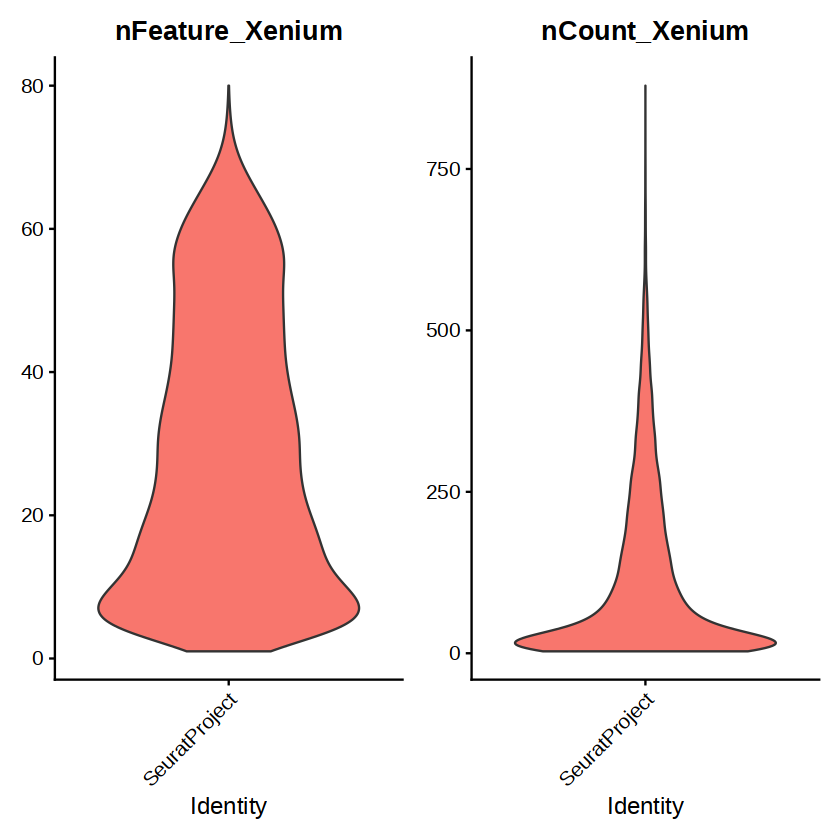

In [7]:
VlnPlot(xenium.obj, features = c("nFeature_Xenium", "nCount_Xenium"), ncol = 2, pt.size = 0)

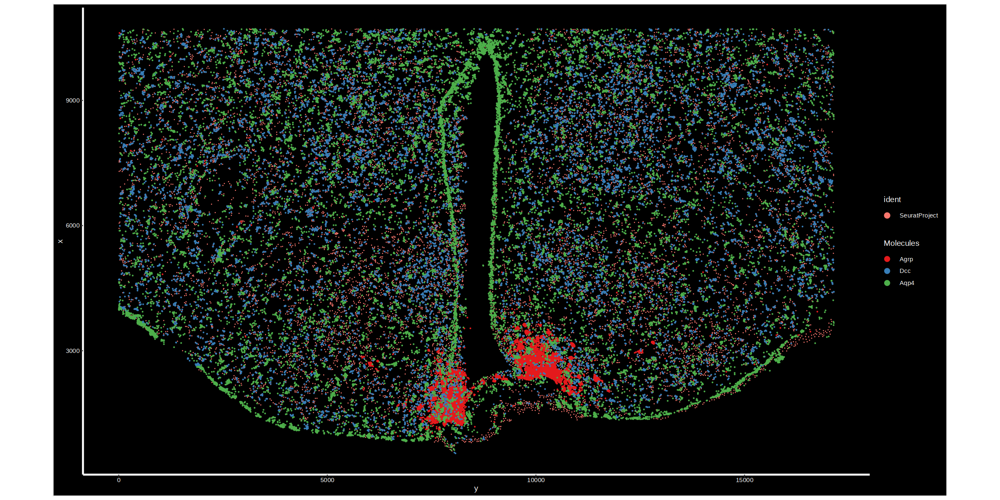

In [8]:
options(repr.plot.width=20, repr.plot.height=10)
ImageDimPlot(xenium.obj, fov = "fov", molecules = c("Agrp", "Dcc", "Aqp4"), nmols = 20000, axes = TRUE)

Warning message:
“Cannot add objects with duplicate keys (offending key: Xenium_), setting key to 'zoom_'”


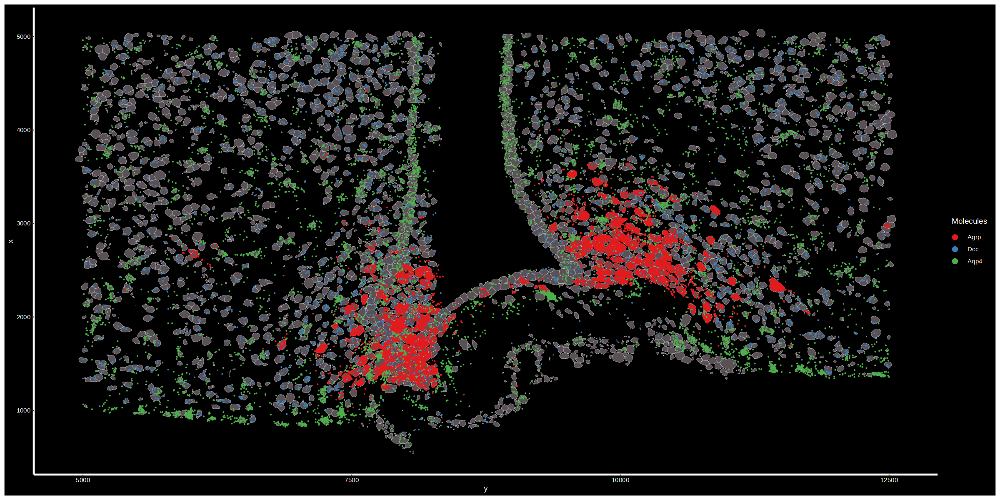

In [9]:
cropped.coords <- Crop(xenium.obj[["fov"]], x = c(5000,12500), y = c(500, 5000), coords = "plot")

xenium.obj[["zoom"]] <- cropped.coords

# visualize cropped area with cell segmentations & selected molecules
DefaultBoundary(xenium.obj[["zoom"]]) <- "segmentation"
ImageDimPlot(xenium.obj, fov = "zoom", axes = TRUE, border.color = "white", border.size = 0.1, cols = "polychrome",
    coord.fixed = FALSE, molecules = c("Agrp", "Dcc", "Aqp4"), nmols = 10000)


In [11]:
# xenium.obj <- RunPCA(xenium.obj, npcs = 30, features = rownames(xenium.obj))

PC_ 1 
Positive:  Plp1, Ptprd, Plcl1, Pcdh9, Oxr1, Plxdc2, Nkain2, Csmd1, Naaladl2, Htr3b 
	   Immp2l, Pcdh11x, Ptprk, Pdgfra, Lrmda, Fhit, Rtl4, Zfp804b, Bmp4, P3h2 
	   Il1rapl2, Gtdc1, Cfap299, Adarb2, Macrod2, Pdzrn3, Car10, Sorcs1, Sgcz, Galntl6 
Negative:  Slc1a2, Gria1, Alcam, Nrxn3, Trpm3, Aqp4, Pcdh7, Col25a1, Fam155a, Ncam2 
	   Rbfox1, Rmst, Tenm3, Kcnip4, Ptprt, Dlg2, Slit2, Tenm2, Fgf13, Luzp2 
	   Ctnna2, Arhgap6, Cacna2d3, Brinp3, Hs3st4, Prkca, Gabrg3, Slc7a11, Cadm2, Gpc5 
PC_ 2 
Positive:  Slc1a2, Aqp4, Slc7a11, Trpm3, Gpc5, Luzp2, Pdgfra, Plp1, Sox5, Rgs6 
	   Rax, Cfap299, Lrmda, Fat3, Cadm2, Gpc6, Bmp4, Pdzrn3, Slit2, Erbb4 
	   Ntm, Plxdc2, Plcb1, Lef1, Naaladl2, Fhit, Rmst, P3h2, Pcdh11x, Plcl1 
Negative:  Nrxn3, Col25a1, Agrp, Rbfox1, Dlg2, Kcnip4, Fam155a, Ncam2, Fgf13, Tenm2 
	   Ctnna2, Grm7, Arhgap6, Hs3st4, Alcam, Pcdh7, Nrg3, Cacna2d3, Nxph1, Grm8 
	   Pde10a, Kcnq3, Sorcs1, Oxr1, Gabrg3, Kctd16, Dcc, Ptprt, Ptprd, Pomc 
PC_ 3 
Positive:  Agrp, Pomc, Arhga

In [12]:
# xenium.obj <- RunUMAP(xenium.obj, dims = 1:30)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
14:26:06 UMAP embedding parameters a = 0.9922 b = 1.112

14:26:06 Read 18986 rows and found 30 numeric columns

14:26:06 Using Annoy for neighbor search, n_neighbors = 30

14:26:06 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:26:10 Writing NN index file to temp file /scratch/nmq407/R_tmp//RtmpLo4ZwM/fileda52193b207

14:26:10 Searching Annoy index using 1 thread, search_k = 3000

14:26:16 Annoy recall = 100%

14:26:17 Commencing smooth kNN distance calibration using 1 thread
 with ta

In [13]:
# xenium.obj <- FindNeighbors(xenium.obj, reduction = "pca", dims = 1:30)

Computing nearest neighbor graph

Computing SNN



In [14]:
# xenium.obj <- FindClusters(xenium.obj, resolution = 0.3)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 18986
Number of edges: 740380

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9025
Number of communities: 16
Elapsed time: 2 seconds


In [10]:
# qs::qsave(xenium.obj, 'xenium_a1_processed')
xenium.obj = qs::qread('xenium_a1_processed')

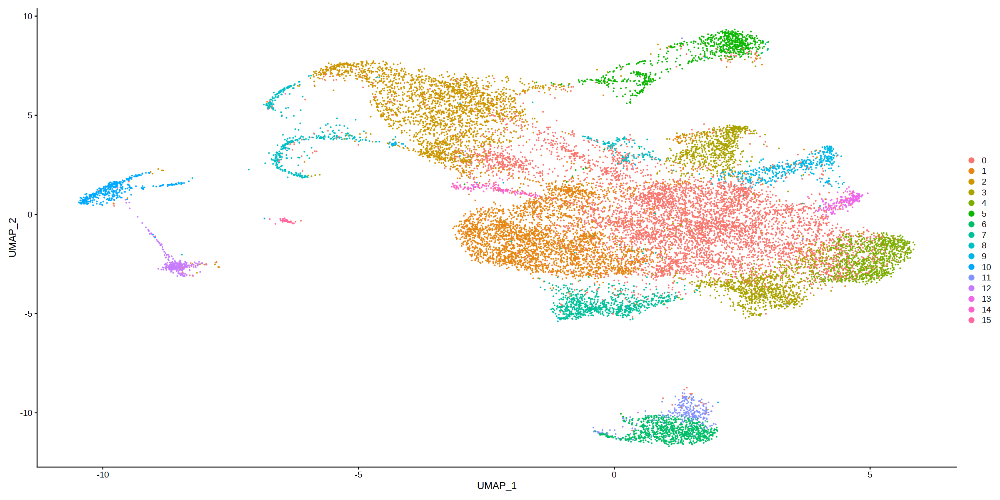

In [11]:
DimPlot(xenium.obj)

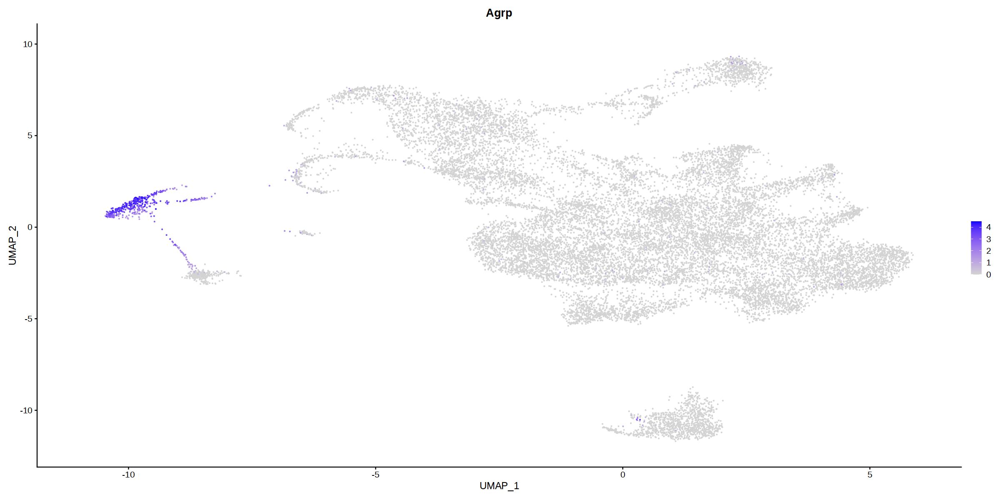

In [12]:
FeaturePlot(xenium.obj, features = c("Agrp"))


In [13]:
# obj_fgf1 = qs::qread('/projects/petar/fgf1/full_obj_sct.qs')
# obj_fgf1

In [14]:
source('../00_preprocessing/preprocessing.R')

In [15]:
# obob5_cells = obj_fgf1 %>%
# `[[` %>%
# filter(strain == 'obob') %>%
# filter(time == 'Day5') %>%
# rownames

In [16]:
# obj_fgf1 = subset(obj_fgf1, cells=obob5_cells)
# obj_fgf1

In [17]:
# obj_fgf1 = obj_fgf1 %>%
# sc_transform_fgf1 
# obj_fgf1

In [18]:
# obj_fgf1 = obj_fgf1 %>% 
# Seurat::RunUMAP(reduction = "pca", dims = 1:30)

In [23]:
# obj_fgf1 %>% qs::qsave('../obob_Day5_obj_sct.qs')
obj_fgf1 = qs::qread('../obob_Day5_obj_sct.qs')

In [25]:
2

[1] 2

In [26]:
# qs::qsave(anchors, 'xenium_a1_anchors.qs')
anchors = qs::qread('xenium_a1_anchors.qs')

In [27]:
xenium.obj_unimapped <- MapQuery(anchorset = anchors, reference = obj_fgf1, query = xenium.obj,
    refdata = list(labels = "labels"), reference.reduction = "pca", reduction.model = "umap")

Finding integration vectors

Finding integration vector weights

Predicting cell labels

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”

Integrating dataset 2 with reference dataset

Finding integration vectors

Integrating data

Computing nearest neighbors

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
Running UMAP projection

17:02:46 Read 18986 rows

17:02:46 Processing block 1 of 1

17:02:46 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

17:02:47 Initializing by weighted average of neighbor coordinates using 1 thread

17:02:47 Commencing optimization for 67 epochs, with 569580 positive edges

17:02:57 Finished



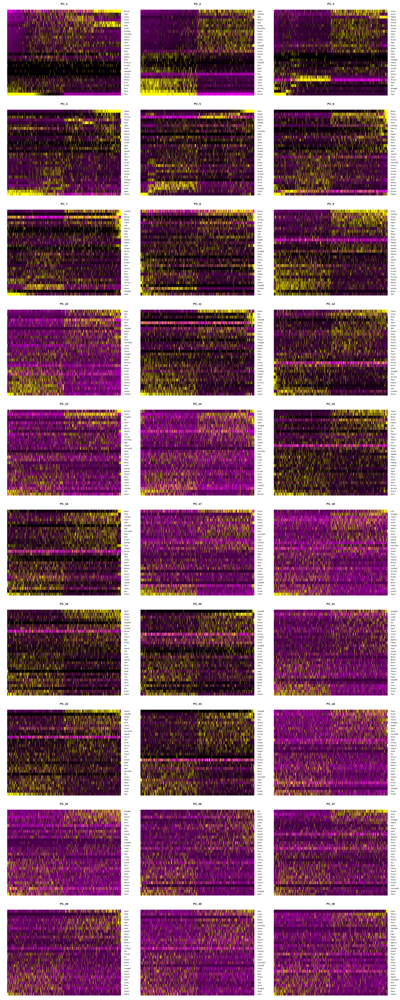

In [28]:
options(repr.plot.width=20, repr.plot.height=50)
DimHeatmap(xenium.obj, dims = 1:30, cells = 5000, balanced = TRUE, assays=c('SCT'), reduction='pca')

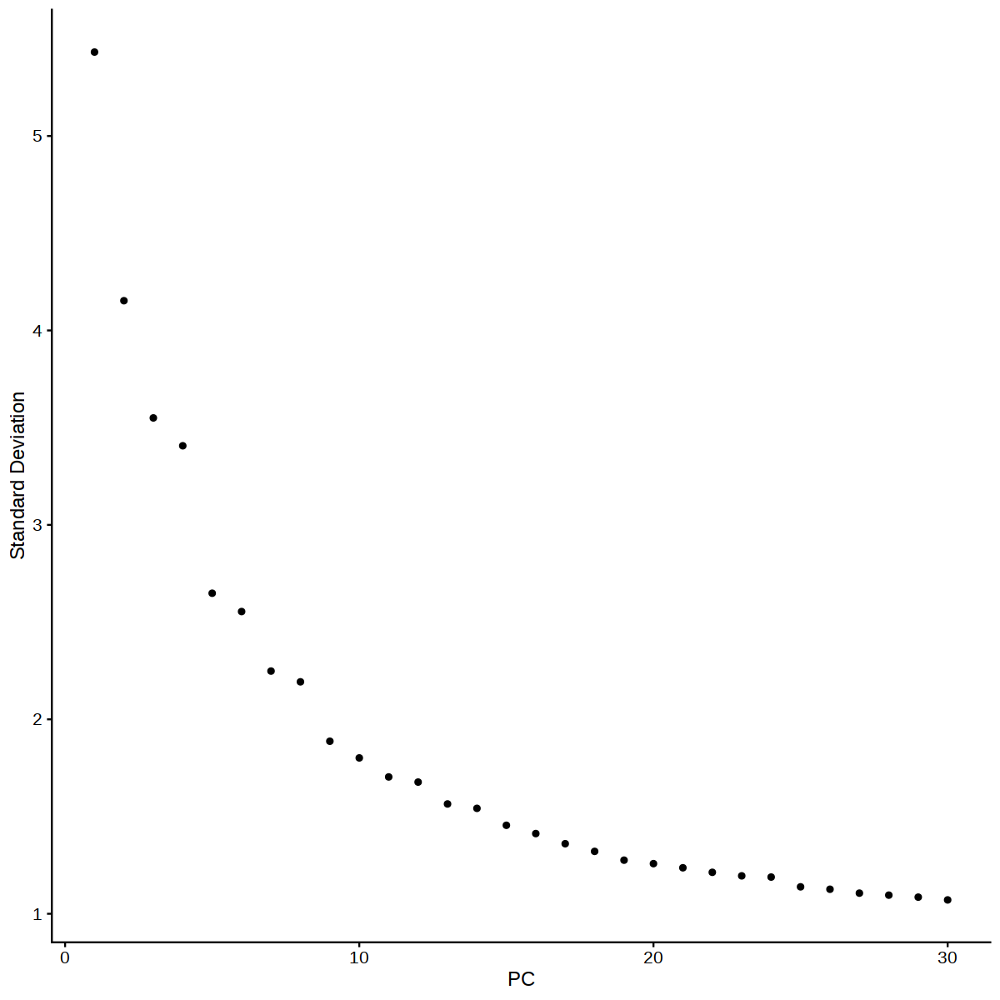

In [30]:
ElbowPlot(xenium.obj, ndims = 30)

Warning message:
“Removed 55 rows containing missing values (geom_point).”
Warning message:
“Removed 2 rows containing missing values (geom_point).”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


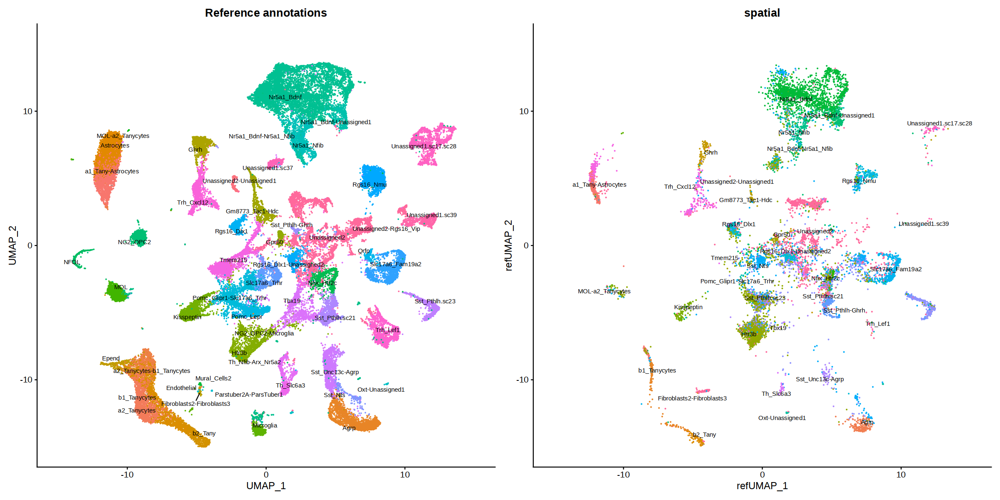

In [31]:
options(repr.plot.width=20, repr.plot.height=10)
p1 <- DimPlot(obj_fgf1, reduction = "umap", group.by = "labels", label = TRUE, label.size = 3, repel = TRUE) + NoLegend() + ggtitle("Reference annotations") + xlim(-15, 15) + ylim(-15, 15)
p2 = DimPlot(xenium.obj_unimapped, group.by = "predicted.labels", reduction = 'ref.umap', label = TRUE, label.size = 3, repel = TRUE) + NoLegend() + ggtitle("spatial") + xlim(-15, 15) + ylim(-15, 15)
p1 + p2

In [32]:
xenium.obj_unimapped

An object of class Seurat 
553 features across 18986 samples within 6 assays 
Active assay: SCT (99 features, 99 variable features)
 5 other assays present: Xenium, BlankCodeword, ControlCodeword, ControlProbe, prediction.score.labels
 4 dimensional reductions calculated: pca, umap, ref.pca, ref.umap
 2 spatial fields of view present: fov zoom

Warning message:
“No FOV associated with assay 'SCT', using global default FOV”


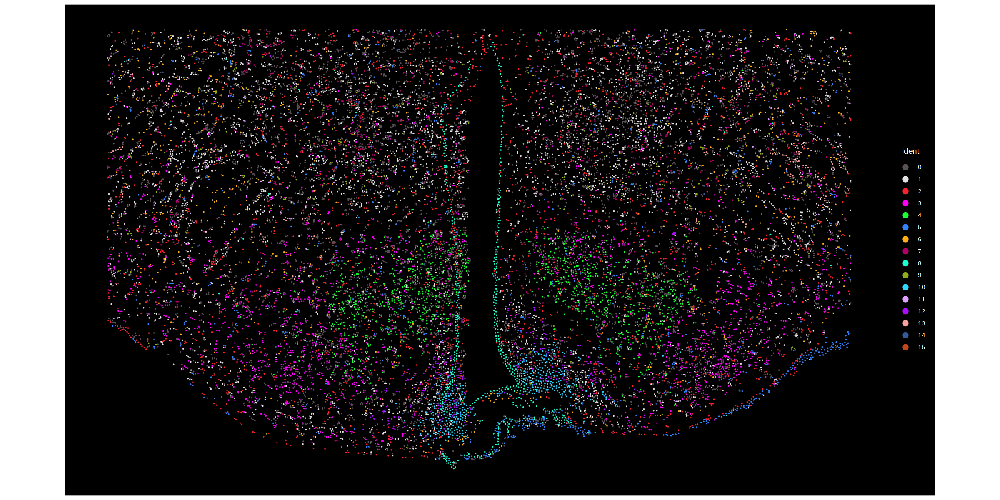

In [33]:
ImageDimPlot(xenium.obj_unimapped, cols = "polychrome", size = 0.75)

Warning message:
“No FOV associated with assay 'SCT', using global default FOV”


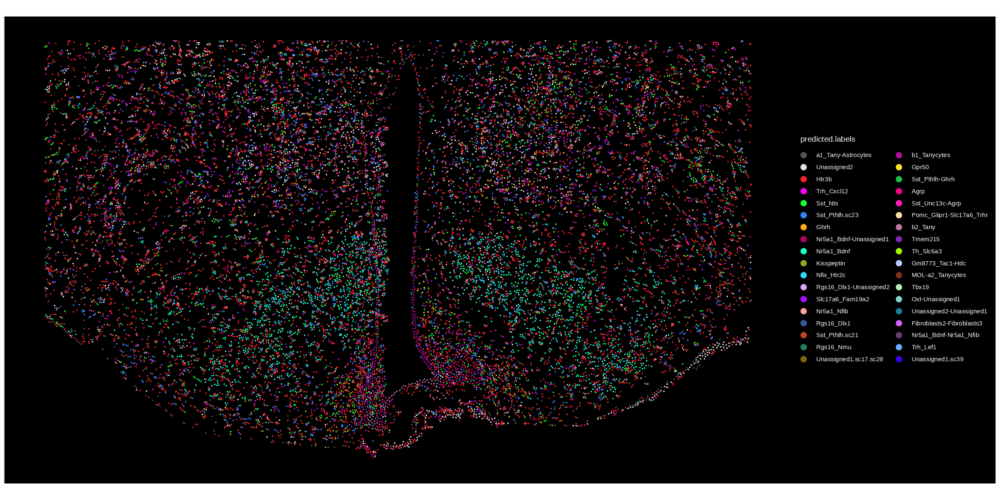

In [34]:
  ImageDimPlot(xenium.obj_unimapped, cols = "polychrome", size = 0.75, group.by = "predicted.labels")

In [35]:
xenium.obj_unimapped@meta.data = xenium.obj_unimapped %>%
`[[` %>%
mutate(Trh_Cxcl12 = case_when(predicted.labels == "Trh_Cxcl12" ~ predicted.labels,
                              TRUE ~ 'other'))

Warning message:
“No FOV associated with assay 'SCT', using global default FOV”


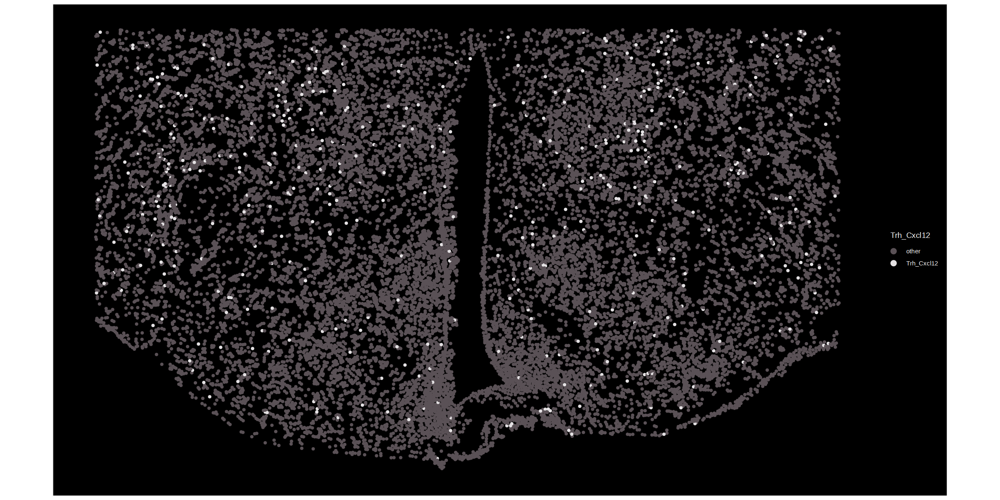

In [36]:
ImageDimPlot(xenium.obj_unimapped, cols = "polychrome", size = 2, group.by = "Trh_Cxcl12")

In [37]:
xenium.obj_unimapped@meta.data = xenium.obj_unimapped %>%
`[[` %>%
mutate(Nr5a1_Bdnf = case_when(str_detect(predicted.labels, fixed("Nr5a1_Bdnf")) ~ predicted.labels,
                              TRUE ~ 'other'))

Warning message:
“No FOV associated with assay 'SCT', using global default FOV”


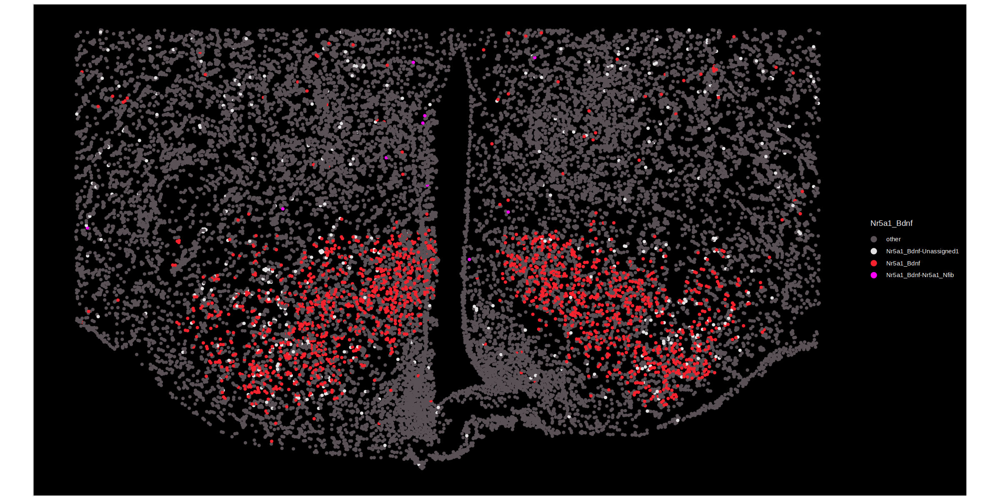

In [38]:
ImageDimPlot(xenium.obj_unimapped, cols = "polychrome", size = 2, group.by = "Nr5a1_Bdnf")

In [39]:
xenium.obj_unimapped@meta.data = xenium.obj_unimapped %>%
`[[` %>%
mutate(Agrp = case_when(str_detect(predicted.labels, fixed("Agrp")) ~ predicted.labels,
                              TRUE ~ 'other'))

Warning message:
“No FOV associated with assay 'SCT', using global default FOV”
Warning message:
“The following variables were found in both object metadata and the default assay: Agrp
Returning metadata; if you want the feature, please use the assay's key (eg. sct_Agrp)”


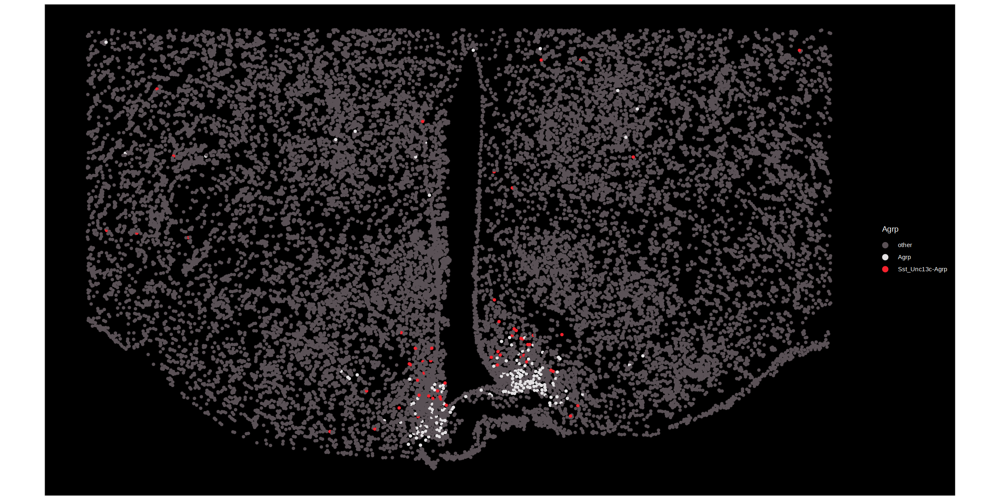

In [40]:
ImageDimPlot(xenium.obj_unimapped, cols = "polychrome", size = 2, group.by = "Agrp")

In [41]:
xenium.obj_unimapped@meta.data = xenium.obj_unimapped %>%
`[[` %>%
mutate(Pomc = case_when(str_detect(predicted.labels, fixed("Pomc")) ~ predicted.labels,
                              TRUE ~ 'other'))

Warning message:
“No FOV associated with assay 'SCT', using global default FOV”
Warning message:
“The following variables were found in both object metadata and the default assay: Pomc
Returning metadata; if you want the feature, please use the assay's key (eg. sct_Pomc)”


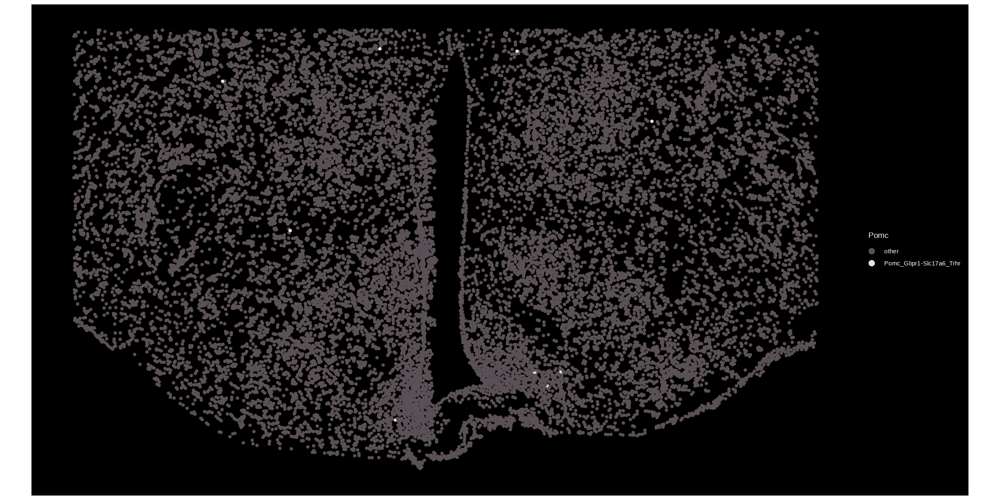

In [42]:
ImageDimPlot(xenium.obj_unimapped, cols = "polychrome", size = 2, group.by = "Pomc")

Warning message in brewer.pal(n = length(x = levels(x = molecules$molecule)), name = "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


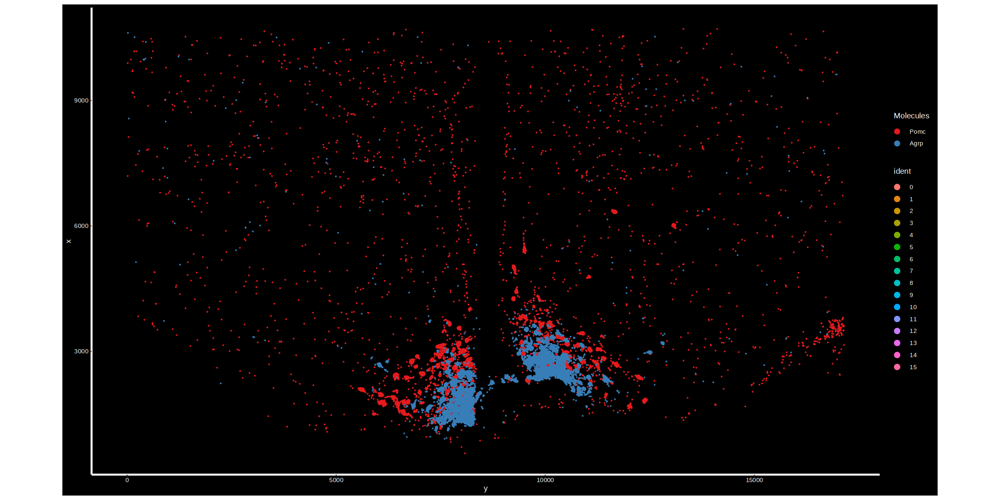

In [43]:
options(repr.plot.width=20, repr.plot.height=10)
ImageDimPlot(xenium.obj, fov = "fov", molecules = c("Pomc", "Agrp"), nmols = 20000, axes = TRUE, size=0)

Warning message in brewer.pal(n = length(x = levels(x = molecules$molecule)), name = "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


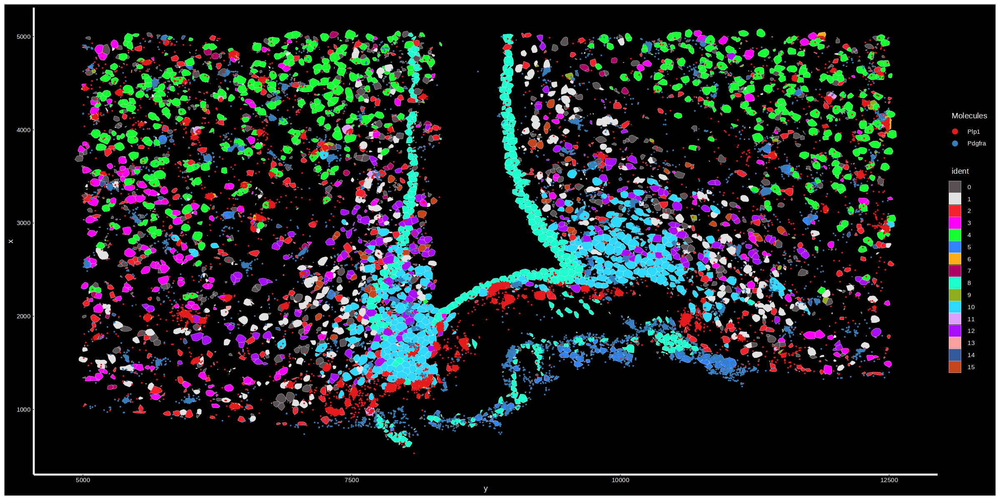

In [44]:
options(repr.plot.width=20, repr.plot.height=10)
# ImageDimPlot(xenium.obj, fov = "fov", molecules = c("Plp1", "Pdgfra"), nmols = 20000, axes = TRUE, size=0)
ImageDimPlot(xenium.obj, fov = "zoom", axes = TRUE, border.color = "white", border.size = 0.1, cols = "polychrome",
    coord.fixed = FALSE, molecules = c("Plp1", "Pdgfra"), nmols = 10000)

In [45]:
xenium.obj_unimapped@meta.data = xenium.obj_unimapped %>%
`[[` %>%
mutate(Pomc = case_when(str_detect(predicted.labels, fixed("Pomc")) ~ predicted.labels,
                              TRUE ~ 'other'))

In [46]:
?ImageDimPlot

ImageDimPlot {Seurat},R Documentation
object,A Seurat object
fov,Name of FOV to plot
boundaries,"A vector of segmentation boundaries per image to plot; can be a character vector, a named character vector, or a named list. Names should be the names of FOVs and values should be the names of segmentation boundaries"
group.by,"Name of one or more metadata columns to group (color) cells by (for example, orig.ident); pass 'ident' to group by identity class"
split.by,Name of a metadata column to split plot by; see FetchData for more details
cols,"Vector of colors, each color corresponds to an identity class. This may also be a single character or numeric value corresponding to a palette as specified by brewer.pal.info. By default, ggplot2 assigns colors. We also include a number of palettes from the pals package. See DiscretePalette for details."
shuffle.cols,Randomly shuffle colors when a palette or vector of colors is provided to cols
size,Point size for cells when plotting centroids
molecules,A vector of molecules to plot
mols.size,Point size for molecules


In [7]:
xenium.obj_unimapped

ERROR: Error in eval(expr, envir, enclos): object 'xenium.obj_unimapped' not found
